# SECTION: INITIAL IMPORTS

In [1]:
# import statements --> SOME OF THESE MAY NOT BE NEEDED
%matplotlib inline 
import numpy as np 

from matplotlib import pyplot as plt 
from matplotlib.ticker import MaxNLocator
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
import colorcet as cc
from matplotlib.patches import Rectangle, FancyArrowPatch
import matplotlib.ticker as ticker
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
import mpl_scatter_density
from astropy.visualization import LogStretch
from astropy.visualization.mpl_normalize import ImageNormalize

import h5py

from astropy.io import fits,ascii,votable
from astropy import units as u 
from astropy import constants as const
from astropy import table
from astropy.cosmology import Planck15,FlatLambdaCDM
from astropy.table import Table

from sklearn.cluster import KMeans
from sklearn import mixture
from itertools import combinations
from sklearn.neighbors import KNeighborsRegressor
from sklearn.utils import check_array
from sklearn.neighbors._base import _get_weights
#imports for TWO-NN
import scipy
from sklearn import neighbors
from sklearn import preprocessing

import scipy.integrate
from scipy.integrate import quad
import numba
from sklearn.datasets import load_digits
import umap
import umap.plot
from umap.umap_ import nearest_neighbors
import pandas as pd
import plotly
import plotly.express as px

#imports for plotly graphing
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import pickle

pd.set_option('display.max_columns', None)

#BRETT NOTEBOOK IMPORTS
from pathlib import Path

from importlib import reload
import utils
reload(utils)
from minisom import MiniSom

# imports from animation_simplified2 notebook
import seaborn as sns
sns.set(style='white', rc={'figure.figsize':(14, 12), 'animation.html': 'html5'})
import os

/Applications/anaconda3/envs/env1/lib/python3.11/site-packages/umap/plot.py:203: NumbaDeprecationWarning: The keyword argument 'nopython=False' was supplied. From Numba 0.59.0 the default is being changed to True and use of 'nopython=False' will raise a warning as the argument will have no effect. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit(nopython=False)


In [2]:
import umapz

# SECTION: DATA PROCESSING

In [3]:
## initial processing from downloaded COSMOS folder: process_COSMOS_MASTER.py

In [4]:
## cuts: HSC_i_MAG < 24.5 ; lp_photoz > 0.01 ; UVISTA_H_MAG < 24.8

##### Read in the COSMOS Spectroscopic Redshift Compilation (CSRC) data, using the appropriate filepath. The version used in our paper is the one only including unique sources, downloaded from https://github.com/cosmosastro/speczcompilation .

##### Require objects have redshifts -0.01 < z < 99, in order to remove probable incorrect redshifts.

In [5]:
# read in the catalog
cat0 = table.Table.read('specz_compilation_COSMOS_DR1.00_unique.fits',format='fits',hdu=1)
# convert to a pandas DataFrame, which I prefer to work with
khostovan_specz = cat0.to_pandas()
# apply cuts to exclude objects with probable redshift measurement failures
min_slice = khostovan_specz['specz'] > -0.01
max_slice = khostovan_specz['specz'] < 99
kh_specz = khostovan_specz[(min_slice) & (max_slice)]


In [6]:
# view the catalog in its raw form
#cat0

In [7]:
# view the pandas DataFrame with the redshift cuts applied, this removes roughly 10k sources
#kh_specz

##### Read in the parquet file produced by process_COSMOS.py containing the COSMOS2020 data, and implement the cuts described in Section 2.1 of our paper. This entails dropping objects for which any of the photometric bands used to define our color space are missing measurements, as well as objects missing photo-z or sSFR measurements. Next, we remove objects with photo-z's less than 0.01 as probable stars, and require that i- and H-band magnitudes be brighter than 24.5 and 24.8, respectively. 

In [8]:
df1 = pd.read_parquet('COSMOS2020_processed.parquet')

df_fullcolors = df1.copy()
df_ = df_fullcolors.dropna(subset=['u-g', 'g-r', 'r-i', 'i-z', 'z-y', 'y-J', 'J-H', 'lp_photoz', 'lp_sSFR_best'])
# lp_sSFR_best is peak of the distribution, lp_sSFR_med is also an option
df7 = df_.loc[(df_['lp_photoz'] > 0.01) & (df_['UVISTA_H_MAG'] < 24.8) & (df_['HSC_i_MAG'] < 24.5)]
# if desired, write out the processed data as a parquet file for convenience
#df7.to_parquet('df7.parquet')

In [9]:
# if the COSMOS2020 data was previously written out, read it in
#df7 = pd.read_parquet('df7.parquet')

##### Perform the spatial crossmatch described in Section 2.2 of our paper, using the crossmatch function in our umapz module.

In [10]:
kh_df7 = umapz.crossmatch(cat1=kh_specz, cat2=df7, coords1=('ra_original', 'dec_original'), coords2=('RA', 'DEC'), id='Id_specz', threshold=0.5)

In [11]:
# view the crossmatched data
#kh_df7

##### Implement the quality cut requiring the Confidence Level be greater than 95, this corresponds to a Q=4 quality flag in standard redshift confidence schemes, or a "very reliable redshift"

In [12]:
spec95 = kh_df7[kh_df7['Confidence_level']>95]
print(len(spec95))

14499


## Figure 1: differences between photometric and spectroscopic samples

/Users/finianashmead/Desktop/NEWMANGROUP/umapz.py:784: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  phot_df['g-z'] = phot_df['HSC_g_MAG'] - phot_df['HSC_z_MAG']
/Users/finianashmead/Desktop/NEWMANGROUP/umapz.py:785: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  spec_df['g-z'] = spec_df['HSC_g_MAG'] - spec_df['HSC_z_MAG']


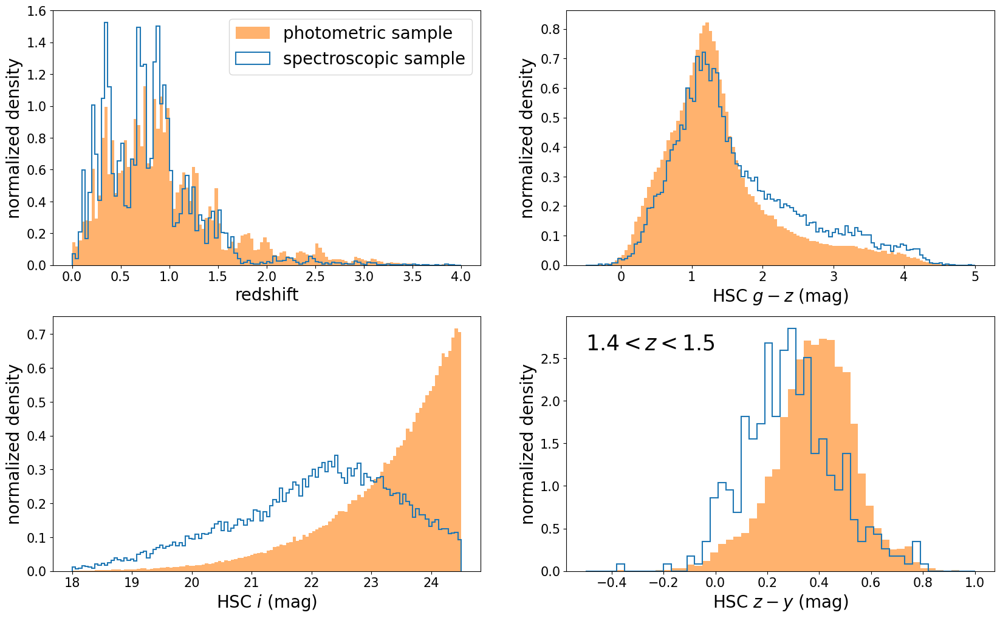

In [13]:
umapz.plot_distributions(phot_df=df7, spec_df=spec95, filename=None);

# SECTION: GENERATE UMAP/SOM

##### generate a UMAP embedding using the dimensionality, distance metric (for the input color space), and hyperparameters described in our paper

In [14]:
UMAP_7colors = umap.UMAP(n_neighbors=80, min_dist=0.0, metric='manhattan', n_components=3, random_state=41, densmap=False).fit(df7[['u-g', 'g-r', 'r-i', 'i-z', 'z-y', 'y-J','J-H']])

/Applications/anaconda3/envs/env1/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


##### save the UMAP coordinates of each object as columns in the DataFrame containing the photometric data; this allows for (i) working with the UMAP positions of the objects in a convenient way, (ii) saving the coordinates along with the rest of the data by writing out the DataFrame as, e.g., a parquet file, and most importantly, (iii) is critical to the way UMAP-kNN-z is implemented

In [15]:
df7['UMAP3D-1'] = UMAP_7colors.embedding_[:,0].copy()
df7['UMAP3D-2'] = UMAP_7colors.embedding_[:,1].copy()
df7['UMAP3D-3'] = UMAP_7colors.embedding_[:,2].copy()

/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3925515870.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df7['UMAP3D-1'] = UMAP_7colors.embedding_[:,0].copy()
/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3925515870.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df7['UMAP3D-2'] = UMAP_7colors.embedding_[:,1].copy()
/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3925515870.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

In [16]:
# write out DataFrame if desired
# df7.to_parquet('df7_UMAP_coords.parquet')

#### generate interactive plots of the UMAP embedding using plotly, this is a convenient way to view the manifold from a variety of angles and zoom in

##### plot the manifold color-coded by LePHARE photo-z:

In [20]:
fig = px.scatter_3d(df7, x=df7['UMAP3D-1'], y=df7['UMAP3D-2'], z=df7['UMAP3D-3'],
                    color=df7['lp_photoz'], color_continuous_scale='turbo', opacity=0.8, title='7 Color UMAP', height=800., width=1000., range_color=(0,3))
fig.update_traces(marker_size=1)
fig.show()

##### plot the manifold color-coded by LePHARE sSFR:

In [21]:
fig = px.scatter_3d(df7, x=df7['UMAP3D-1'], y=df7['UMAP3D-2'], z=df7['UMAP3D-3'],
                    color=df7['lp_sSFR_best'], color_continuous_scale='RdBu', opacity=0.8, title='7 Color UMAP', height=800., width=1000., range_color=(-12,-8))
fig.update_traces(marker_size=1)
fig.show()

#### we can also match the spectroscopic data to the new df7 (containing the UMAP coordinates) in order to view the manifold populated only with sources with spec-z's:

In [ ]:
# create a version of df7 containing only objects that are also in the spectroscopic dataset
df7_spec = df7.copy()[df7['ID'].isin(spec95['ID'])]
# merge this version with the columns of the spectroscopic dataset containing the source ID and the spec-z
df_spec_umap = pd.merge(df7_spec, spec95[['ID', 'specz']], left_on='ID', right_on='ID', how='left')

,ID,RA,DEC,FLAG_COMBINED,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_u_MAGERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_g_MAGERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_r_MAGERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_i_MAGERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_z_MAGERR,HSC_y_FLUX,HSC_y_FLUXERR,HSC_y_MAGERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_J_MAGERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_H_MAGERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,UVISTA_Ks_MAGERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH1_MAGERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,IRAC_CH2_MAGERR,lp_photoz,lp_type,lp_zp_2,lp_NbFilt,lp_zq,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MNUV,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_sSFR_best,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG,u-g,g-r,r-i,i-z,z-y,y-J,J-H,g-z,UMAP3D-1,UMAP3D-2,UMAP3D-3,specz
0,535,150.726526,1.795723,0,3.135322,0.004911,0.001979,3.543392,0.005600,0.001707,4.149280,0.006839,0.001707,5.531073,0.006686,0.001311,9.094858,0.011055,0.001310,6.137582,0.023292,0.003891,8.654985,0.055195,0.006917,8.847195,0.061729,0.007971,10.089081,0.037653,0.004077,12.819075,0.017958,0.001854,8.697933,0.024042,0.003679,0.8165,0,NaN,28,1.85,8,1.609000e+08,0.2,1,-20.28363,-21.12927,-21.52369,9.31240,9.27122,9.34644,9.33645,1.23468,-8.087,22.659295,22.526452,22.355068,22.042977,21.503010,21.930007,21.556834,21.532986,21.390371,21.130358,21.551460,0.132843,0.171384,0.312092,0.539966,-0.426997,0.373173,0.023848,1.023442,-1.975816,1.218150,0.035435,0.82589
1,670,149.730259,1.959835,0,1.941518,0.005379,0.003476,1.863746,0.004178,0.002408,2.359093,0.005581,0.002440,3.347864,0.005832,0.001883,4.712861,0.009339,0.002130,5.044670,0.019908,0.004038,5.936375,0.013675,0.002495,7.337306,0.017588,0.002736,9.483263,0.026426,0.003042,13.707825,0.014322,0.001382,12.806878,0.012845,0.001335,1.1792,0,NaN,30,1.02,10,2.273000e+08,0.3,0,-20.49749,-21.89549,-22.47231,9.79095,9.75692,9.83047,9.80739,1.80017,-7.953,23.179647,23.224033,22.968137,22.588081,22.216789,22.142918,21.966197,21.736158,21.457606,21.057579,21.131392,-0.044386,0.255896,0.380057,0.371292,0.073870,0.176721,0.230038,1.007245,-0.919792,-0.326218,5.726158,1.16549
2,692,149.642181,2.379960,0,1.315313,0.006756,0.006467,4.484449,0.005892,0.001415,13.213070,0.007819,0.000612,24.048380,0.008534,0.000384,35.020987,0.013526,0.000416,40.134805,0.026583,0.000678,66.579523,0.061359,0.000999,98.679499,0.078428,0.000908,133.665136,0.058089,0.000475,81.719072,0.032358,0.000524,83.615927,0.028347,0.000451,0.3269,0,NaN,29,0.29,9,5.000000e+09,0.4,1,-16.72223,-20.57175,-21.94677,10.35539,10.31772,10.39305,10.38281,0.19029,-10.190,23.602427,22.270727,21.097491,20.447285,20.039179,19.891197,19.341648,18.914433,18.584955,19.119191,19.094277,1.331700,1.173237,0.650205,0.408106,0.147982,0.549549,0.427216,2.231548,6.842029,6.652438,3.014578,0.30572
3,1143,150.589033,1.889879,0,0.063290,0.003653,0.072636,0.254108,0.004009,0.016990,1.155916,0.005216,0.004662,4.069362,0.005549,0.001476,6.650530,0.009029,0.001461,8.661979,0.019250,0.002276,14.262715,0.022103,0.001680,23.028622,0.020338,0.001009,32.456397,0.027529,0.000926,NaN,NaN,NaN,26.183528,0.044004,0.002237,0.7986,0,NaN,28,0.64,1,2.000000e+09,0.0,0,-16.79230,-21.67922,-22.74348,10.34975,10.31558,10.38392,10.32480,-6.09950,-16.440,26.896659,25.387452,23.742684,22.376184,21.842859,21.555957,21.014494,20.494330,20.121749,NaN,20.354930,1.509207,1.644768,1.366500,0.533325,0.286902,0.541463,0.520164,3.544593,8.448165,4.241317,3.651629,0.80030
4,1245,149.971382,1.711330,0,1.695707,0.006863,0.005056,1.691740,0.005530,0.003500,2.357181,0.007089,0.003094,3.366750,0.007567,0.002425,5.704886,0.012347,0.002323,6.829482,0.025867,0.003871,9.471108,0.059377,0.006786,13.002449,0.077023,0.006759,18.572509,0.051679,0.003037,29.470112,0.016731,0.000751,28.078737,0.017725,0.000840,1.2540,0,NaN,29,1.09,7,2.600000e+09,0.2,0,-20.53407,-22.57335,-23.39578,10.59188,10.55031,10.64044,10.62809,1.40000,-9.214,23.326623,23.329

##### plot the manifold color-coded by spec-z:

In [25]:
fig = px.scatter_3d(df_spec_umap, x=df_spec_umap['UMAP3D-1'], y=df_spec_umap['UMAP3D-2'], z=df_spec_umap['UMAP3D-3'],
                    color=df_spec_umap['specz'], color_continuous_scale='turbo', opacity=0.8, title='7 Color UMAP', height=800., width=1000., range_color=(0,3))
fig.update_traces(marker_size=1)
fig.show()

#### generate a SOM projection of the photometric data

In [27]:
# path for saving SOM files
path = '/Users/finianashmead/Desktop/NEWMANGROUP/'
directory = 'path_pck'
path_pck = Path(path+directory)

In [28]:
# identify the columns of the DataFrame containing the colors used to define the input color space
df7.iloc[:,66:73]

,u-g,g-r,r-i,i-z,z-y,y-J,J-H
7,-0.176089,0.415457,0.572198,0.093968,0.015911,0.165153,0.056011
39,0.224942,0.858989,0.266428,0.177680,0.190035,0.045137,0.103637
40,0.100310,0.036027,0.055918,0.079228,0.392517,0.358380,0.058847
46,-0.025406,0.115376,0.443442,0.305974,0.094628,0.103980,0.050585
57,-0.033620,0.233163,0.237504,0.620941,0.191580,0.080971,0.250305
...,...,...,...,...,...,...,...
746927,0.020444,0.324796,0.600126,0.232996,0.078006,0.297927,-0.063207
746931,0.435377,0.339485,0.522655,0.300355,0.669516,0.512737,0.342779
746932,0.025642,0.243967,0.429374,0.557310,-0.413649,0.397465,-0.027508
746934,0.188626,0.590556,0.540123,0.129911,0.099868,0.273816,0.218295


In [29]:
# specify the data that will go into the SOM
# the colors are the input data for the generation of the SOM mapping
data1 = df7.iloc[:, 66:73].values
# the photo-z's and sSFRs
z_train1 = df7['lp_photoz'].values
ssfr1 = df7['lp_sSFR_best'].values
n_colors = 7

##### be advised: generating the SOM mapping will likely take significantly longer than generating the UMAP embedding

In [ ]:
n_som_xy = (50, 100)

som_model_id = 'example_notebook_som'
path_pck_som = path_pck / som_model_id
filename_som_model = path_pck_som / f'{som_model_id}.pck'
filename_som_obj_cell_coord = path_pck_som / f'som_obj_cell_coord_{som_model_id}.pck'
filename_som_cell_counts = path_pck_som / f'som_cell_counts_{som_model_id}.pck'
filename_som_z_median_cell = path_pck_som / f'som_z_median_cell_{som_model_id}.pck'
filename_som_sigma_z_cell = path_pck_som / f'som_sigma_z_cell_{som_model_id}.pck'
filename_som_ssfr_median_cell = path_pck_som / f'som_ssfr_median_cell_{som_model_id}.pck'

if filename_som_model.exists():
    with open(filename_som_model, 'rb') as infile:
        som = pickle.load(infile)

    with open(filename_som_obj_cell_coord, 'rb') as infile:
        obj_cell_coord = pickle.load(infile)

    with open(filename_som_cell_counts, 'rb') as infile:
        cell_counts = pickle.load(infile)
    
    with open(filename_som_z_median_cell, 'rb') as infile:
        z_median_cell = pickle.load(infile)

    with open(filename_som_ssfr_median_cell, 'rb') as infile:
        ssfr_median_cell = pickle.load(infile)
        
    with open(filename_som_sigma_z_cell, 'rb') as infile:
        sigma_z_cell = pickle.load(infile)
    

else:
    som = MiniSom(n_som_xy[0], n_som_xy[1], n_colors, sigma=1., learning_rate=0.8, random_seed=42)
    som.train(data1, num_iteration=2_000_000)
    obj_cell_coord, cell_counts = utils.objects_per_cell(som, data1, n_som_xy)
    z_median_cell = utils.median_z_per_cell(obj_cell_coord, z_train1, n_som_xy)
    sigma_z_cell = utils.sigma_z_per_cell(obj_cell_coord, z_train1, n_som_xy)
    ssfr_median_cell = utils.median_z_per_cell(obj_cell_coord, ssfr1, n_som_xy)

    with open(filename_som_model, 'wb') as outfile:
        pickle.dump(som, outfile)

    with open(filename_som_obj_cell_coord, 'wb') as outfile:
        pickle.dump(obj_cell_coord, outfile)

    with open(filename_som_cell_counts, 'wb') as outfile:
        pickle.dump(cell_counts, outfile)

    with open(filename_som_z_median_cell, 'wb') as outfile:
        pickle.dump(z_median_cell, outfile)

    with open(filename_som_sigma_z_cell, 'wb') as outfile:
        pickle.dump(sigma_z_cell, outfile)

    with open(filename_som_ssfr_median_cell, 'wb') as outfile:
        pickle.dump(ssfr_median_cell, outfile)

print('Done')

Done


LOADED


/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3731907248.py:32: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3731907248.py:34: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3731907248.py:36: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



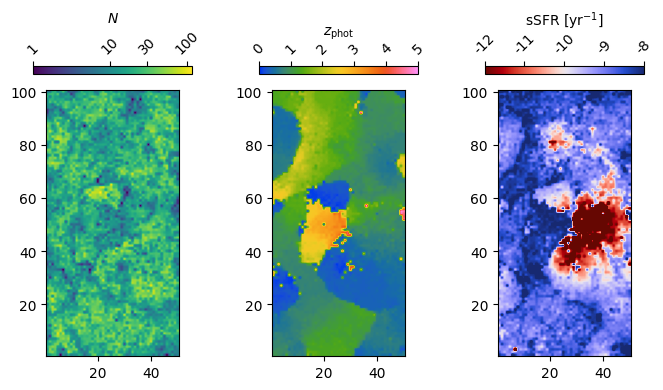

In [32]:
som_model_id = 'example_notebook_som'
path_pck_som = path_pck / som_model_id
filename_som_model = path_pck_som / f'{som_model_id}.pck'
filename_som_obj_cell_coord = path_pck_som / f'som_obj_cell_coord_{som_model_id}.pck'
filename_som_cell_counts = path_pck_som / f'som_cell_counts_{som_model_id}.pck'
filename_som_z_median_cell = path_pck_som / f'som_z_median_cell_{som_model_id}.pck'
filename_som_sigma_z_cell = path_pck_som / f'som_sigma_z_cell_{som_model_id}.pck'
filename_som_ssfr_median_cell = path_pck_som / f'som_ssfr_median_cell_{som_model_id}.pck'

if filename_som_model.exists():
    with open(filename_som_model, 'rb') as infile:
        som = pickle.load(infile)

    with open(filename_som_obj_cell_coord, 'rb') as infile:
        obj_cell_coord = pickle.load(infile)

    with open(filename_som_cell_counts, 'rb') as infile:
        cell_counts = pickle.load(infile)
    
    with open(filename_som_z_median_cell, 'rb') as infile:
        z_median_cell = pickle.load(infile)

    with open(filename_som_ssfr_median_cell, 'rb') as infile:
        ssfr_median_cell = pickle.load(infile)

print('LOADED')
# SOM colored by galaxies per cell and median photo-z per cell
fig, axes = plt.subplots(ncols=3, figsize=(8, 4))
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0)
data = (np.log10(cell_counts), z_median_cell, ssfr_median_cell)
labels = (r'$N$', r'$z_\mathrm{phot}$', r'sSFR [yr$^{-1}$]')
mycm1 = plt.cm.get_cmap('viridis').copy()
mycm1.set_bad('gray', 0.2)
mycm2 = plt.cm.get_cmap('cet_CET_R1').copy()
mycm2.set_bad('gray', 0.2)
mycm3 = plt.cm.get_cmap('cet_CET_D1A_r').copy()
mycm3.set_bad('gray', 0.2)
cmaps = (mycm1, mycm2, mycm3)
vmaxs = (None, 5, -8)
vmins = [None, 0, -12]
for ii, (ax, dd, label, cmap) in enumerate(zip(axes, data, labels, cmaps)):
    ax.grid(False)
    extent = (0.5, n_som_xy[0] + 0.5, 0.5, n_som_xy[1] + 0.5)
    im = ax.imshow(dd.T, extent=extent, origin='lower', cmap=cmap, vmin=vmins[ii], vmax=vmaxs[ii])
    
    cb = fig.colorbar(im, ax=ax, location='top', shrink=0.5)
    cb.set_label(label)
    if ii == 0:
        ticklabels = np.array([1, 10, 30, 100])
        ticks_loc = np.log10(ticklabels)
        cb.set_ticks(ticks_loc)
    elif ii == 2:
        ticks_loc = np.array([-12, -11, -10, -9, -8])
        ticklabels = ticks_loc
        cb.set_ticks(ticks_loc)
    else:
        ticks_loc = np.array([0, 1, 2, 3, 4, 5])
        ticklabels = ticks_loc
        cb.set_ticks(ticks_loc)
    
    cb.ax.set_xticklabels(ticklabels, rotation=45)

    fig.tight_layout()

fig.tight_layout()

In [37]:
# convert the SOM coordinates of each object into a numpy array
occ_array = np.array(obj_cell_coord)
# similarly to with the UMAP embedding, save the SOM coordinates of each object to the DataFrame
df7['SOM-1'] = occ_array[:,0].copy()
df7['SOM-2'] = occ_array[:,1].copy()
df7

/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3286694261.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/zr/5945lkps2z573rnydx977g7m0000gn/T/ipykernel_17487/3286694261.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,ID,RA,DEC,FLAG_COMBINED,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_u_MAGERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_g_MAGERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_r_MAGERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_i_MAGERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_z_MAGERR,HSC_y_FLUX,HSC_y_FLUXERR,HSC_y_MAGERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_J_MAGERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_H_MAGERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,UVISTA_Ks_MAGERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH1_MAGERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,IRAC_CH2_MAGERR,lp_photoz,lp_type,lp_zp_2,lp_NbFilt,lp_zq,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MNUV,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_sSFR_best,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG,u-g,g-r,r-i,i-z,z-y,y-J,J-H,g-z,UMAP3D-1,UMAP3D-2,UMAP3D-3,SOM-1,SOM-2
7,12,150.476809,2.331511,0,0.432424,0.006043,0.017385,0.367684,0.004799,0.013929,0.539085,0.006673,0.012705,0.913139,0.006940,0.008187,0.995689,0.010382,0.011179,1.010389,0.021430,0.021652,1.176385,0.018240,0.016771,1.238664,0.023098,0.021265,1.273614,0.031158,0.026693,0.793401,0.012663,0.021113,0.623383,0.011264,0.024039,0.7070,0,NaN,30,0.00,5,9.048000e+08,0.1,1,-17.59872,-18.85507,-18.93651,8.69380,8.65194,8.74706,8.64422,-0.18369,-8.815,24.810225,24.986313,24.570856,23.998658,23.904690,23.888779,23.723626,23.667616,23.637405,24.151268,24.413112,-0.176089,0.415457,0.572198,0.093968,0.015911,0.165153,0.056011,1.081623,-0.675568,3.697633,-0.883083,5,73
39,73,149.468025,1.625609,0,1.057806,0.006321,0.007477,1.301316,0.007003,0.005769,2.870638,0.011023,0.003954,3.669017,0.012785,0.003763,4.321371,0.018494,0.004597,5.147967,0.045866,0.009110,5.366495,0.022263,0.004492,5.903986,0.031370,0.006063,6.666023,0.046399,0.007598,4.142945,0.036884,0.011779,4.426406,0.054762,0.016462,0.4290,0,NaN,30,0.34,9,1.609000e+09,0.2,1,-17.40718,-19.16920,-19.50800,9.06086,9.01925,9.10800,9.01447,0.08064,-8.977,23.838985,23.614043,22.755054,22.488626,22.310946,22.120911,22.075773,21.972137,21.840333,22.356727,22.284872,0.224942,0.858989,0.266428,0.177680,0.190035,0.045137,0.103637,1.303097,1.062053,5.966409,-0.891955,47,27
40,74,150.488035,1.875422,0,0.941051,0.003713,0.004937,1.032136,0.004159,0.004320,1.066959,0.005443,0.005254,1.123350,0.005748,0.005525,1.208387,0.008979,0.007981,1.734654,0.019518,0.011504,2.413042,0.014805,0.006643,2.547439,0.017875,0.008007,2.257407,0.024673,0.011931,2.951406,0.013003,0.005829,3.054308,0.014661,0.006387,1.5087,0,NaN,29,2.23,10,9.048000e+08,0.1,1,-20.37010,-21.24365,-21.42674,9.49598,9.44923,9.54398,9.50023,0.99993,-8.536,23.965967,23.865658,23.829631,23.773713,23.694485,23.301968,22.943588,22.884741,23.015975,22.724928,22.687718,0.100310,0.036027,0.055918,0.079228,0.392517,0.358380,0.058847,0.171173,0.701737,4.123773,10.293687,17,95
46,85,150.476436,2.334178,0,0.685237,0.005227,0.009492,0.669388,0.004202,0.006701,0.744438,0.005884,0.008114,1.119968,0.005803,0.005582,1.484551,0.008772,0.006335,1.619744,0.018884,0.011903,1.782537,0.015855,0.009621,1.867551,0.020190,0.012329,2.274360,0.027033,0.012969,2.573668,0.012908,0.006634,1.992754,0.011691,0.007805,1.0800,0,NaN,29,2.19,5,2.273000e+08,0.2,0,-19.16843,-20.47925,-20.51206,9.14079,9.10236,9.18581,9.12799,0.90000,-8.234,24.310399,24.335805,24.220428,23.776986,23.471012,23.376384,23.272404,23.221819,23.007852,22.873619,23.151366,-0.025406,0.115376,0.443442,0.305974,0.094628,0.103980,0.050585,0.864793,-1.647700,-0.580940,5.356029,5,48
57,104,149.475722,1.626313,0,0.389645,0.004690,0.015066,0.377765,0.005186,0.014719,0.468260,0.008271,0.018192,0.582758,0.009130,0.016919,1.032440,0.013830,0.014389,1.231677,0.034203,0.028396,1.327044,0.017144,0.013989,1.671119,0.023782,0.016241,1.823997,0.035115,0.021015,2.302721,0.033234,0.019095,2.590386,0.044562,0.022890,1.2817,0,NaN,29,1.01,7,5.709000e+08,0.2,0,-18.94804,-20.47051,-20.73870,9.42859,9.36886,9.49659,9.40345,0.76785,-8.597,24.923327,24.956946,24.723783,24.4

In [28]:
# write out DataFrame if desired
# df7.to_parquet('df7_all_coords.parquet')

##### At this point, with the UMAP and SOM coordinates determined for each object in the photometric dataset, it is convenient to store all of the necessary information in a single DataFrame each for the photometric and spectroscopic datasets. This is also necessary for the visualization and redshift estimation functionality demonstrated below.

##### The df7 DataFrame contains all of the photometric colors, LePHARE quantities, and UMAP and SOM coordinates, so we need to identify the objects with spec-z's and create a DataFrame containing the quantities mentioned above in addition to the spectroscopic redshifts.

In [39]:
spec95 = pd.merge(spec95, df7[['ID', 'UMAP3D-1', 'UMAP3D-2', 'UMAP3D-3', 'SOM-1', 'SOM-2']], 
                      left_on='ID', right_on='ID', how='left')
# view the DataFrame
spec95

,ID,RA,DEC,FLAG_COMBINED,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_u_MAGERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_g_MAGERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_r_MAGERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_i_MAGERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_z_MAGERR,HSC_y_FLUX,HSC_y_FLUXERR,HSC_y_MAGERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_J_MAGERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_H_MAGERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,UVISTA_Ks_MAGERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH1_MAGERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,IRAC_CH2_MAGERR,lp_photoz,lp_type,lp_zp_2,lp_NbFilt,lp_zq,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MNUV,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_sSFR_best,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG,u-g,g-r,r-i,i-z,z-y,y-J,J-H,nearest_cat1_ID,nearest_cat1_sep,Id_specz,Id_original,ra_original,dec_original,ra_corrected,dec_corrected,Priority,specz,flag,Confidence_level,survey,compilation_year,public_or_private,Id_COS20_Classic,ra_COS20_Classic,dec_COS20_Classic,Id_COS20_Farmer,ra_COS20_Farmer,dec_COS20_Farmer,Id_COSMOS15,ra_COSMOS15,dec_COSMOS15,Id_COSMOS09,ra_COSMOS09,dec_COSMOS09,photoz,photoz_type,g-z,UMAP3D-1,UMAP3D-2,UMAP3D-3,SOM-1,SOM-2
0,535,150.726526,1.795723,0,3.135322,0.004911,0.001979,3.543392,0.005600,0.001707,4.149280,0.006839,0.001707,5.531073,0.006686,0.001311,9.094858,0.011055,0.001310,6.137582,0.023292,0.003891,8.654985,0.055195,0.006917,8.847195,0.061729,0.007971,10.089081,0.037653,0.004077,12.819075,0.017958,0.001854,8.697933,0.024042,0.003679,0.8165,0,NaN,28,1.85,8,1.609000e+08,0.2,1,-20.28363,-21.12927,-21.52369,9.31240,9.27122,9.34644,9.33645,1.23468,-8.087,22.659295,22.526452,22.355068,22.042977,21.503010,21.930007,21.556834,21.532986,21.390371,21.130358,21.551460,0.132843,0.171384,0.312092,0.539966,-0.426997,0.373173,0.023848,57552,0.032255,57552,b'3962782953',150.72652,1.79573,150.72652,1.79573,1,0.82589,4,97,29,2023,1,393505,150.726503,1.795736,535,150.726526,1.795723,334248,150.726575,1.795797,495080,150.72654,1.795808,0.7747,0,1.023442,-1.975816,1.218150,0.035435,11,32
1,670,149.730259,1.959835,0,1.941518,0.005379,0.003476,1.863746,0.004178,0.002408,2.359093,0.005581,0.002440,3.347864,0.005832,0.001883,4.712861,0.009339,0.002130,5.044670,0.019908,0.004038,5.936375,0.013675,0.002495,7.337306,0.017588,0.002736,9.483263,0.026426,0.003042,13.707825,0.014322,0.001382,12.806878,0.012845,0.001335,1.1792,0,NaN,30,1.02,10,2.273000e+08,0.3,0,-20.49749,-21.89549,-22.47231,9.79095,9.75692,9.83047,9.80739,1.80017,-7.953,23.179647,23.224033,22.968137,22.588081,22.216789,22.142918,21.966197,21.736158,21.457606,21.057579,21.131392,-0.044386,0.255896,0.380057,0.371292,0.073870,0.176721,0.230038,54582,0.166286,54582,b'3962783555',149.73022,1.95986,149.73022,1.95986,1,1.16549,4,97,29,2023,1,562463,149.730243,1.959851,670,149.730259,1.959835,437916,149.730268,1.959866,816008,149.73022,1.959921,1.1465,0,1.007245,-0.919792,-0.326218,5.726158,30,13
2,692,149.642181,2.379960,0,1.315313,0.006756,0.006467,4.484449,0.005892,0.001415,13.213070,0.007819,0.000612,24.048380,0.008534,0.000384,35.020987,0.013526,0.000416,40.134805,0.026583,0.000678,66.579523,0.061359,0.000999,98.679499,0.078428,0.000908,133.665136,0.058089,0.000475,81.719072,0.032358,0.000524,83.615927,0.028347,0.000451,0.3269,0,NaN,29,0.29,9,5.000000e+09,0.4,1,-16.72223,-20.57175,-21.94677,10.35539,10.31772,10.39305,10.38281,0.19029,-10.190,23.602427,22.270727,21.097491,20.447285,20.039179,19.891197,19.341648,18.914433,18.584955,19.119191,19.094277,1.331700,1.173237,0.650205,0.408106,0.147982,0.549549,0.427216,134345,0.069986,134345,b'174323',149.64220,2.37996,149.64217,2.37995,1,0.30572,4,97,105,2018,1,1020227,149.642181,2.379958,692,149.642181,2.379960,715344,149.642185,2.379964,1306281,149.64216,2.379982,0.3098,0,2.231548,6.842029,6.652438,3.014578,36,35
3,1143,150.589033,1.889879,0,0.063290,0.003653,0.072636,0.254108,0.004009,0.016990,1.155916,0.005216,0.004662,4.0

# SECTION: UMAP/SOM VISUALIZATIONS

In [4]:
df7 = pd.read_parquet('df7_maps_250819.parquet')
spec95 = pd.read_parquet('spec95_ugrizyJH_maps_250819.parquet')
spec95

,ID,RA,DEC,FLAG_COMBINED,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_u_MAGERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_g_MAGERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_r_MAGERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_i_MAGERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_z_MAGERR,HSC_y_FLUX,HSC_y_FLUXERR,HSC_y_MAGERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_J_MAGERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_H_MAGERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,UVISTA_Ks_MAGERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH1_MAGERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,IRAC_CH2_MAGERR,lp_photoz,lp_type,lp_zp_2,lp_NbFilt,lp_zq,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MNUV,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_sSFR_best,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG,u-g,g-r,r-i,i-z,z-y,y-J,J-H,nearest_cat1_ID,nearest_cat1_sep,Id_specz,Id_original,ra_original,dec_original,ra_corrected,dec_corrected,Priority,specz,flag,Confidence_level,survey,compilation_year,public_or_private,Id_COS20_Classic,ra_COS20_Classic,dec_COS20_Classic,Id_COS20_Farmer,ra_COS20_Farmer,dec_COS20_Farmer,Id_COSMOS15,ra_COSMOS15,dec_COSMOS15,Id_COSMOS09,ra_COSMOS09,dec_COSMOS09,photoz,photoz_type,UMAP3D-1,UMAP3D-2,UMAP3D-3,SOM-1,SOM-2
0,535,150.726526,1.795723,0,3.135322,0.004911,0.001979,3.543392,0.005600,0.001707,4.149280,0.006839,0.001707,5.531073,0.006686,0.001311,9.094858,0.011055,0.001310,6.137582,0.023292,0.003891,8.654985,0.055195,0.006917,8.847195,0.061729,0.007971,10.089081,0.037653,0.004077,12.819075,0.017958,0.001854,8.697933,0.024042,0.003679,0.8165,0,NaN,28,1.85,8,1.609000e+08,0.2,1,-20.28363,-21.12927,-21.52369,9.31240,9.27122,9.34644,9.33645,1.23468,-8.087,22.659295,22.526452,22.355068,22.042977,21.503010,21.930007,21.556834,21.532986,21.390371,21.130358,21.551460,0.132843,0.171384,0.312092,0.539966,-0.426997,0.373173,0.023848,57552,0.032255,57552,b'3962782953',150.72652,1.79573,150.72652,1.79573,1,0.82589,4,97,29,2023,1,393505,150.726503,1.795736,535,150.726526,1.795723,334248,150.726575,1.795797,495080,150.72654,1.795808,0.7747,0,-1.975816,1.218150,0.035435,11,32
1,670,149.730259,1.959835,0,1.941518,0.005379,0.003476,1.863746,0.004178,0.002408,2.359093,0.005581,0.002440,3.347864,0.005832,0.001883,4.712861,0.009339,0.002130,5.044670,0.019908,0.004038,5.936375,0.013675,0.002495,7.337306,0.017588,0.002736,9.483263,0.026426,0.003042,13.707825,0.014322,0.001382,12.806878,0.012845,0.001335,1.1792,0,NaN,30,1.02,10,2.273000e+08,0.3,0,-20.49749,-21.89549,-22.47231,9.79095,9.75692,9.83047,9.80739,1.80017,-7.953,23.179647,23.224033,22.968137,22.588081,22.216789,22.142918,21.966197,21.736158,21.457606,21.057579,21.131392,-0.044386,0.255896,0.380057,0.371292,0.073870,0.176721,0.230038,54582,0.166286,54582,b'3962783555',149.73022,1.95986,149.73022,1.95986,1,1.16549,4,97,29,2023,1,562463,149.730243,1.959851,670,149.730259,1.959835,437916,149.730268,1.959866,816008,149.73022,1.959921,1.1465,0,-0.919792,-0.326218,5.726158,30,13
2,692,149.642181,2.379960,0,1.315313,0.006756,0.006467,4.484449,0.005892,0.001415,13.213070,0.007819,0.000612,24.048380,0.008534,0.000384,35.020987,0.013526,0.000416,40.134805,0.026583,0.000678,66.579523,0.061359,0.000999,98.679499,0.078428,0.000908,133.665136,0.058089,0.000475,81.719072,0.032358,0.000524,83.615927,0.028347,0.000451,0.3269,0,NaN,29,0.29,9,5.000000e+09,0.4,1,-16.72223,-20.57175,-21.94677,10.35539,10.31772,10.39305,10.38281,0.19029,-10.190,23.602427,22.270727,21.097491,20.447285,20.039179,19.891197,19.341648,18.914433,18.584955,19.119191,19.094277,1.331700,1.173237,0.650205,0.408106,0.147982,0.549549,0.427216,134345,0.069986,134345,b'174323',149.64220,2.37996,149.64217,2.37995,1,0.30572,4,97,105,2018,1,1020227,149.642181,2.379958,692,149.642181,2.379960,715344,149.642185,2.379964,1306281,149.64216,2.379982,0.3098,0,6.842029,6.652438,3.014578,36,35
3,1143,150.589033,1.889879,0,0.063290,0.003653,0.072636,0.254108,0.004009,0.016990,1.155916,0.005216,0.004662,4.069362,0.005549,0.001476,6.65053

#### Using the umapz module, plot the SOM projection with cells color-coded by number of galaxies (left), redshift (center), and sSFR (right), with the top row corresponding to the photometric dataset, the middle row corresponding to a random subset of the photometric dataset of the same size as the spectroscopic dataset, and the bottom row corresponding to the spectroscopic dataset. This 3x3 figure corresponds to Figure 2 in our paper.

/Users/finianashmead/Desktop/NEWMANGROUP/umapz.py:708: RuntimeWarning: divide by zero encountered in log10
  (np.log10(cell_counts_50_lp), z_median_cell_50_lp, ssfr_median_cell_50_lp),
/Users/finianashmead/Desktop/NEWMANGROUP/umapz.py:709: RuntimeWarning: divide by zero encountered in log10
  (np.log10(cell_counts_50_s), z_median_cell_50_s, ssfr_median_cell_50_s)


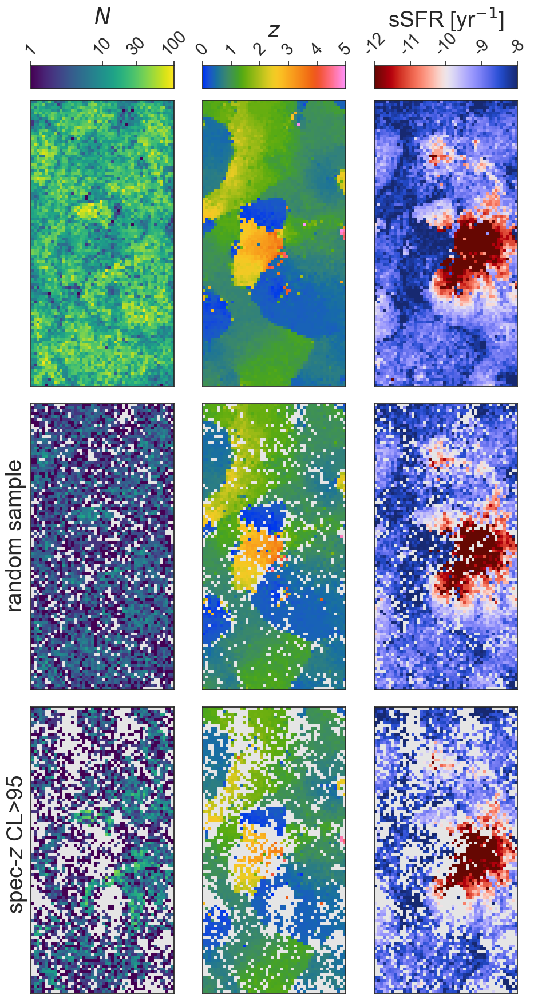

In [5]:
umapz.plot_som(phot_df=df7, spec_df=spec95, map='SOM', size=(50,100), filename=None);

##### In order to create the animation linked to in the paper (of which Figures 3 and 4 contain selected frames), we can use the code below, making use of more functions in our umapz module.

##### In the case of the animation linked to (and the figures appearing in) our paper, we used 200 frames, of which frames 155, 175, 185, and 195 are shown in Figures 3 and 4. The individual frames are stitched together using ffmpeg commands.

In [62]:
# first, create directories in which the frames will be stored
parent_path = "~/Desktop/NEWMANGROUP/"
output_dir = os.path.expanduser(parent_path+"z_spec")
os.makedirs(output_dir, exist_ok=True)
output_dir = os.path.expanduser(parent_path+"ssfr_spec")
os.makedirs(output_dir, exist_ok=True)
output_dir = os.path.expanduser(parent_path+"z_phot")
os.makedirs(output_dir, exist_ok=True)
output_dir = os.path.expanduser(parent_path+"ssfr_phot")
os.makedirs(output_dir, exist_ok=True)

##### Use the umapz save_frame and combine_and_animate functions to generate the individual frames, and stitch them together into four-panel images and an mp4 animation. This will likely take quite some time to run, in my case 20 frames took nearly 9 minutes. As such, if viewing the animated UMAP embedding is not a primary concern, I recommend skipping ahead and coming back to this later, as this has no importance to the redshift estimation functionality. I also note that for different datasets, or different combinations of axis and colorbar labels, this code may not be sufficiently flexible, as I am not highly proficient in animation.

In [63]:
# define the number of frames, in the paper we used 200
num_frames=10

# loop over the desired number of frames to save an image of each of the four plots at the appropriate viewing angles
for i in range(num_frames):
    umapz.save_frame(num_frames=num_frames, index=i, df=spec95, output_dir='z_spec', title=None, cbar=True, color='specz')
    umapz.save_frame(num_frames=num_frames, index=i, df=spec95, output_dir='ssfr_spec', title=None, cbar=True, color='lp_sSFR_best')
    umapz.save_frame(num_frames=num_frames, index=i, df=df7, output_dir='z_phot', title=None, cbar=True, color='lp_photoz')
    umapz.save_frame(num_frames=num_frames, index=i, df=df7, output_dir='ssfr_phot', title=None, cbar=True, color='lp_sSFR_best')

Saving frame 0 to z_spec/frame_0000.png
Cropped and overwritten: z_spec/frame_0000.png
Saving frame 0 to ssfr_spec/frame_0000.png
Cropped and overwritten: ssfr_spec/frame_0000.png
Saving frame 0 to z_phot/frame_0000.png
Cropped and overwritten: z_phot/frame_0000.png
Saving frame 0 to ssfr_phot/frame_0000.png
Cropped and overwritten: ssfr_phot/frame_0000.png
Saving frame 1 to z_spec/frame_0001.png
Cropped and overwritten: z_spec/frame_0001.png
Saving frame 1 to ssfr_spec/frame_0001.png
Cropped and overwritten: ssfr_spec/frame_0001.png
Saving frame 1 to z_phot/frame_0001.png
Cropped and overwritten: z_phot/frame_0001.png
Saving frame 1 to ssfr_phot/frame_0001.png
Cropped and overwritten: ssfr_phot/frame_0001.png
Saving frame 2 to z_spec/frame_0002.png
Cropped and overwritten: z_spec/frame_0002.png
Saving frame 2 to ssfr_spec/frame_0002.png
Cropped and overwritten: ssfr_spec/frame_0002.png
Saving frame 2 to z_phot/frame_0002.png
Cropped and overwritten: z_phot/frame_0002.png
Saving frame 

In [66]:
umapz.combine_and_animate(
    z_phot="z_phot",
    ssfr_phot="ssfr_phot",
    z_spec="z_spec",
    ssfr_spec="ssfr_spec",
    framerate=15
)

Creating twopanel_phot...


ffmpeg version 7.0 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libopenvino --enab

Creating twopanel_spec...


ffmpeg version 7.0 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libopenvino --enab

Creating fourpanel...


ffmpeg version 7.0 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libopenvino --enab

Creating final four-panel animation (MP4)...


ffmpeg version 7.0 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libopenvino --enab

Animation created successfully: {output_mp4}


[out#0/mp4 @ 0x7fabd1a225c0] video:1809KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.061396%
frame=   20 fps=2.5 q=-1.0 Lsize=    1810KiB time=00:00:01.20 bitrate=12353.7kbits/s speed=0.153x    
[libx264 @ 0x7fabd1a23440] frame I:1     Avg QP:22.44  size:102388
[libx264 @ 0x7fabd1a23440] frame P:6     Avg QP:23.39  size: 96664
[libx264 @ 0x7fabd1a23440] frame B:13    Avg QP:25.96  size: 89912
[libx264 @ 0x7fabd1a23440] consecutive B-frames: 10.0% 10.0%  0.0% 80.0%
[libx264 @ 0x7fabd1a23440] mb I  I16..4: 22.5% 54.4% 23.1%
[libx264 @ 0x7fabd1a23440] mb P  I16..4:  7.1% 15.8% 16.2%  P16..4:  4.5%  4.6%  1.8%  0.0%  0.0%    skip:50.0%
[libx264 @ 0x7fabd1a23440] mb B  I16..4:  3.9%  4.3%  9.4%  B16..8: 11.9% 10.7%  4.3%  direct: 1.0%  skip:54.4%  L0:48.2% L1:41.3% BI:10.6%
[libx264 @ 0x7fabd1a23440] 8x8 transform intra:36.3% inter:27.6%
[libx264 @ 0x7fabd1a23440] coded y,uvDC,uvAC intra: 46.5% 25.4% 24.6% inter: 9.3% 4.1% 3.0%
[libx264 @ 0x7fabd1a23

# SECTION: REDSHIFT ESTIMATION / PERFORMANCE TESTING

##### The redshift estimation code is implemented in the interpolator function of umapz, for both UMAP-kNN-z and SOM-z as described in our paper. This function takes the training and target datasets as inputs, as well as arguments describing the low-dimensional mapping to be used, the number of neighbors to be used in UMAP-kNN-z or the side length of the shorter side of the SOM, the calculation method to be used (e.g., median vs mean), and the label of the column containing the true redshifts (e.g., lp_photoz or specz).

##### First, we need to define our train and test samples. Here, we create the two distinct training sets and their corresponding test sets, as described in Section 4.1 of our paper. 

In [4]:
df7 = pd.read_parquet('df7_maps_250819.parquet')
spec95 = pd.read_parquet('spec95_ugrizyJH_maps_250819.parquet')

In [5]:
# TRAIN/TEST SPLIT
df = df7.copy()
# randomize the order of the photometric dataset
df_random = df.sample(n=len(df), random_state=2)
# the training set for the spec-z-trained case is just the entire spectroscopic dataset:
df_train_spec = spec95.copy()
# the test set for the spec-z-trained case is all of the sources in the photometric dataset without spec-z's:
df_test_spec = df7.copy()[~df7['ID'].isin(spec95['ID'])]
# the training set for the LePHARE-trained case is a random subset of the photometric dataset, of equal size to the
# spectroscopic dataset:
df_test_lp = df_random[:len(df)-len(df_train_spec)]
df_train_lp = df_random[len(df)-len(df_train_spec):len(df)]

##### Having defined our training and test datasets, we can use our interpolator function to calculate redshifts for the objects in the test datasets based on those in the training datasets:

In [76]:
reload(umapz)

<module 'umapz' from '/Users/finianashmead/Desktop/NEWMANGROUP/umapz.py'>

In [6]:
# these next lines should take only a few seconds each, with the SOM calculations taking longer than the UMAP ones
# calculate the UMAP-kNN-z redshifts of the test set in the spec-z-trained case:
umap_test_spec = umapz.interpolator(df_train_spec, df_test_spec, map='UMAP3D', dim=3, nn=17, calc='median', z_true='specz')
# calculate the UMAP-kNN-z redshifts of the test set in the LePHARE-trained case:
umap_test_lp = umapz.interpolator(df_train_lp, df_test_lp, map='UMAP3D', dim=3, nn=17, calc='median', z_true='lp_photoz')
# calculate the SOM-z redshifts of the test set in the spec-z-trained case:
som_test_spec = umapz.interpolator(df_train_spec, df_test_spec, map='SOM', nn=50, dim=2, calc='median', z_true='specz')
# calculate the SOM-z redshifts of the test set in the LePHARE-trained case:
som_test_lp = umapz.interpolator(df_train_lp, df_test_lp, map='SOM', nn=50, dim=2, calc='median', z_true='lp_photoz')

##### The interpolator function output is a copy of the DataFrame containing the test dataset (the second argument of the function), with an added column labeled TEST_Z corresponding to the UMAP-kNN-z or SOM-z redshift estimates. Using umap_test_spec as an example:

In [7]:
umap_test_spec

,ID,RA,DEC,FLAG_COMBINED,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_u_MAGERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_g_MAGERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_r_MAGERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_i_MAGERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_z_MAGERR,HSC_y_FLUX,HSC_y_FLUXERR,HSC_y_MAGERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_J_MAGERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_H_MAGERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,UVISTA_Ks_MAGERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH1_MAGERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,IRAC_CH2_MAGERR,lp_photoz,lp_type,lp_zp_2,lp_NbFilt,lp_zq,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MNUV,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_sSFR_best,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG,u-g,g-r,r-i,i-z,z-y,y-J,J-H,SOM-1,SOM-2,UMAP3D-1,UMAP3D-2,UMAP3D-3,TEST_Z
7,12,150.476809,2.331511,0,0.432424,0.006043,0.017385,0.367684,0.004799,0.013929,0.539085,0.006673,0.012705,0.913139,0.006940,0.008187,0.995689,0.010382,0.011179,1.010389,0.021430,0.021652,1.176385,0.018240,0.016771,1.238664,0.023098,0.021265,1.273614,0.031158,0.026693,0.793401,0.012663,0.021113,0.623383,0.011264,0.024039,0.7070,0,NaN,30,0.00,5,9.048000e+08,0.1,1,-17.59872,-18.85507,-18.93651,8.69380,8.65194,8.74706,8.64422,-0.18369,-8.815,24.810225,24.986313,24.570856,23.998658,23.904690,23.888779,23.723626,23.667616,23.637405,24.151268,24.413112,-0.176089,0.415457,0.572198,0.093968,0.015911,0.165153,0.056011,5,73,-0.675568,3.697633,-0.883083,0.69540
39,73,149.468025,1.625609,0,1.057806,0.006321,0.007477,1.301316,0.007003,0.005769,2.870638,0.011023,0.003954,3.669017,0.012785,0.003763,4.321371,0.018494,0.004597,5.147967,0.045866,0.009110,5.366495,0.022263,0.004492,5.903986,0.031370,0.006063,6.666023,0.046399,0.007598,4.142945,0.036884,0.011779,4.426406,0.054762,0.016462,0.4290,0,NaN,30,0.34,9,1.609000e+09,0.2,1,-17.40718,-19.16920,-19.50800,9.06086,9.01925,9.10800,9.01447,0.08064,-8.977,23.838985,23.614043,22.755054,22.488626,22.310946,22.120911,22.075773,21.972137,21.840333,22.356727,22.284872,0.224942,0.858989,0.266428,0.177680,0.190035,0.045137,0.103637,47,27,1.062053,5.966409,-0.891955,0.46450
40,74,150.488035,1.875422,0,0.941051,0.003713,0.004937,1.032136,0.004159,0.004320,1.066959,0.005443,0.005254,1.123350,0.005748,0.005525,1.208387,0.008979,0.007981,1.734654,0.019518,0.011504,2.413042,0.014805,0.006643,2.547439,0.017875,0.008007,2.257407,0.024673,0.011931,2.951406,0.013003,0.005829,3.054308,0.014661,0.006387,1.5087,0,NaN,29,2.23,10,9.048000e+08,0.1,1,-20.37010,-21.24365,-21.42674,9.49598,9.44923,9.54398,9.50023,0.99993,-8.536,23.965967,23.865658,23.829631,23.773713,23.694485,23.301968,22.943588,22.884741,23.015975,22.724928,22.687718,0.100310,0.036027,0.055918,0.079228,0.392517,0.358380,0.058847,17,95,0.701737,4.123773,10.293687,1.56504
46,85,150.476436,2.334178,0,0.685237,0.005227,0.009492,0.669388,0.004202,0.006701,0.744438,0.005884,0.008114,1.119968,0.005803,0.005582,1.484551,0.008772,0.006335,1.619744,0.018884,0.011903,1.782537,0.015855,0.009621,1.867551,0.020190,0.012329,2.274360,0.027033,0.012969,2.573668,0.012908,0.006634,1.992754,0.011691,0.007805,1.0800,0,NaN,29,2.19,5,2.273000e+08,0.2,0,-19.16843,-20.47925,-20.51206,9.14079,9.10236,9.18581,9.12799,0.90000,-8.234,24.310399,24.335805,24.220428,23.776986,23.471012,23.376384,23.272404,23.221819,23.007852,22.873619,23.151366,-0.025406,0.115376,0.443442,0.305974,0.094628,0.103980,0.050585,5,48,-1.647700,-0.580940,5.356029,1.08382
57,104,149.475722,1.626313,0,0.389645,0.004690,0.015066,0.377765,0.005186,0.014719,0.468260,0.008271,0.018192,0.582758,0.009130,0.016919,1.032440,0.013830,0.014389,1.231677,0.034203,0.028396,1.327044,0.017144,0.013989,1.671119,0.023782,0.016241,1.823997,0.035115,0.021015,2.302721,0.033234,0.019095,2.590386,0.044562,0.022890,1.2817,0,NaN,29,1.01,7,5.709000e+08,0.2,0,-18.94804,-20.47051,-20.73870,9.42859,9.36886,9.49659,9.40345,0.76785,-8.597,24.923327,24.956946,24.723783,24.48

##### Next, we can calculate the performance statistics described in Section 4.2 of our paper using the umapz functions calc_nmad, f_outlier, and calc_bias. The i_vals argument contains the interpolated redshifts, and the t_vals argument contains the "true" redshifts (the LePHARE-z's in our case). 

##### For the f_outlier function, there are two additional optional arguments: missing (default=0), which can accept a number of objects missing redshift estimates (i.e. objects SOM-z could not estimate redshifts for due to no training redshifts in the cell), and threshold (default=0.15), which can be used to change the outlier threshold. The default value of 0.15 is common in the photo-z literature, and is what we use in our paper.

##### First, we can calculate the performance statistics for UMAP-kNN-z, for the full test sample, in both training cases.

In [8]:
# calculate the performance statistics for UMAP-kNN-z, LePHARE-trained case, full test sample: 
print('UMAP-kNN-z, LePHARE-trained case:')
print('NMAD:', np.round(umapz.calc_nmad(i_vals=umap_test_lp['TEST_Z'], t_vals=umap_test_lp['lp_photoz']),4))
print('f_outlier:', np.round(umapz.f_outlier(i_vals=umap_test_lp['TEST_Z'], t_vals=umap_test_lp['lp_photoz']),4))
print('bias:', np.round(umapz.calc_bias(i_vals=umap_test_lp['TEST_Z'], t_vals=umap_test_lp['lp_photoz']),4))

UMAP-kNN-z, LePHARE-trained case:
NMAD: 0.0216
f_outlier: 0.0219
bias: 0.006


In [9]:
# calculate the performance statistics for UMAP-kNN-z, spec-z-trained case, full test sample: 
print('UMAP-kNN-z, spec-z-trained case:')
print('NMAD:', np.round(umapz.calc_nmad(i_vals=umap_test_spec['TEST_Z'], t_vals=umap_test_spec['lp_photoz']),4))
print('f_outlier:', np.round(umapz.f_outlier(i_vals=umap_test_spec['TEST_Z'], t_vals=umap_test_spec['lp_photoz']),4))
print('bias:', np.round(umapz.calc_bias(i_vals=umap_test_spec['TEST_Z'], t_vals=umap_test_spec['lp_photoz']),4))

UMAP-kNN-z, spec-z-trained case:
NMAD: 0.025
f_outlier: 0.0242
bias: 0.0044


##### Next, we can calculate the performance statistics for SOM-z. Since SOM-z is unable to estimate redshifts of objects in cells with no training redshifts, the NMAD and bias values will only include objects that were able to have redshifts estimated. For f_outlier, we can calculate it including only objects with redshift estimates, as for NMAD and bias, and calculate it including the objects missing redshift estimates as outliers:

In [10]:
# first, calculate the number of test objects for which redshifts could not be estimated
# this is a simple subtraction:
missed_lp = len(df_test_lp) - len(som_test_lp)
print('test objects missing SOM-z redshift estimates, LePHARE-trained case:', missed_lp)
missed_spec = len(df_test_spec) - len(som_test_spec)
print('test objects missing SOM-z redshift estimates, spec-z-trained case:', missed_spec)

test objects missing SOM-z redshift estimates, LePHARE-trained case: 6870
test objects missing SOM-z redshift estimates, spec-z-trained case: 22958


In [11]:
# next, calculate performance statistics for SOM-z, LePHARE-trained case:
print('SOM-z, LePHARE-trained case:')
print('NMAD (trained cells only):', np.round(umapz.calc_nmad(i_vals=som_test_lp['TEST_Z'], t_vals=som_test_lp['lp_photoz']),4))
print('f_outlier (all cells):', np.round(umapz.f_outlier(i_vals=som_test_lp['TEST_Z'], t_vals=som_test_lp['lp_photoz'], missing=missed_lp),4))
print('f_outlier (trained cells only):', np.round(umapz.f_outlier(i_vals=som_test_lp['TEST_Z'], t_vals=som_test_lp['lp_photoz'], missing=0),4))
print('bias (trained cells only):', np.round(umapz.calc_bias(i_vals=som_test_lp['TEST_Z'], t_vals=som_test_lp['lp_photoz']),4))

SOM-z, LePHARE-trained case:
NMAD (trained cells only): 0.0239
f_outlier (all cells): 0.0905
f_outlier (trained cells only): 0.0218
bias (trained cells only): 0.0063


In [12]:
# calculate performance statistics for SOM-z, spec-z-trained case:
print('SOM-z, spec-z-trained case:')
print('NMAD (trained cells only):', np.round(umapz.calc_nmad(i_vals=som_test_spec['TEST_Z'], t_vals=som_test_spec['lp_photoz']),4))
print('f_outlier (all cells):', np.round(umapz.f_outlier(i_vals=som_test_spec['TEST_Z'], t_vals=som_test_spec['lp_photoz'], missing=missed_spec),4))
print('f_outlier (trained cells only):', np.round(umapz.f_outlier(i_vals=som_test_spec['TEST_Z'], t_vals=som_test_spec['lp_photoz'], missing=0),4))
print('bias (trained cells only):', np.round(umapz.calc_bias(i_vals=som_test_spec['TEST_Z'], t_vals=som_test_spec['lp_photoz']),4))

SOM-z, spec-z-trained case:
NMAD (trained cells only): 0.0251
f_outlier (all cells): 0.2544
f_outlier (trained cells only): 0.026
bias (trained cells only): 0.0024


##### Since SOM-z is unable to estimate redshifts for objects with no training redshifts in the same cell, we can calculate the performance statistics for UMAP-kNN-z considering only objects for which SOM-z made a redshift estimate, in order to compare the two with identical test samples. The results of this comparison are reported in Section 4.3 of our paper.

In [13]:
# create versions of the DataFrames containing the UMAP-kNN-z estimates, including only objects with SOM-z estimates:
umap_tcellsonly_lp = umap_test_lp.copy()[umap_test_lp['ID'].isin(som_test_lp['ID'])]
umap_tcellsonly_spec = umap_test_spec.copy()[umap_test_spec['ID'].isin(som_test_spec['ID'])]

In [14]:
# calculate performance statistics for UMAP-kNN-z, LePHARE-trained case, for only objects with SOM-z estimates:
print('UMAP-kNN-z, LePHARE-trained case, objects with SOM-z estimates only:')
print('NMAD (trained cells only):', np.round(umapz.calc_nmad(i_vals=umap_tcellsonly_lp['TEST_Z'], t_vals=umap_tcellsonly_lp['lp_photoz']),4))
print('f_outlier (trained cells only):', np.round(umapz.f_outlier(i_vals=umap_tcellsonly_lp['TEST_Z'], t_vals=umap_tcellsonly_lp['lp_photoz']),4))
print('bias (trained cells only):', np.round(umapz.calc_bias(i_vals=umap_tcellsonly_lp['TEST_Z'], t_vals=umap_tcellsonly_lp['lp_photoz']),4))

UMAP-kNN-z, LePHARE-trained case, objects with SOM-z estimates only:
NMAD (trained cells only): 0.0209
f_outlier (trained cells only): 0.0169
bias (trained cells only): 0.0051


In [15]:
# calculate performance statistics for UMAP-kNN-z, spec-z-trained case, for only objects with SOM-z estimates:
print('UMAP-kNN-z, spec-z-trained case, objects with SOM-z estimates only:')
print('NMAD (trained cells only):', np.round(umapz.calc_nmad(i_vals=umap_tcellsonly_spec['TEST_Z'], t_vals=umap_tcellsonly_spec['lp_photoz']),4))
print('f_outlier (trained cells only):', np.round(umapz.f_outlier(i_vals=umap_tcellsonly_spec['TEST_Z'], t_vals=umap_tcellsonly_spec['lp_photoz']),4))
print('bias (trained cells only):', np.round(umapz.calc_bias(i_vals=umap_tcellsonly_spec['TEST_Z'], t_vals=umap_tcellsonly_spec['lp_photoz']),4))

UMAP-kNN-z, spec-z-trained case, objects with SOM-z estimates only:
NMAD (trained cells only): 0.0223
f_outlier (trained cells only): 0.0131
bias (trained cells only): 0.002


# SECTION: PERFORMANCE IN REDSHIFT BINS

##### Using the z_binned_stats function in umapz, we can produce a figure plotting the redshift estimation performance statistics in redshift bins. This plot corresponds to Figure 5 in our paper.

##### To use this function, we need to provide the full test catalogs for the LePHARE-trained and spec-z-trained cases, (the fullcat_lp and fullcat_spec arguments), as well as the DataFrames containing the redshifts estimated using UMAP-kNN-z and SOM-z for both training cases (the umap_test_lp, umap_test_spec, som_test_lp, and som_test_spec arguments). The i_vals argument takes the string defining the DataFrame column containing the interpolated redshift values, and so is 'TEST_Z' by default, while the t_vals argument takes the string defining the DataFrame column containing the "true" redshift values, and so is 'lp_photoz' by default (recall that the vast majority of our catalog objects do not have spec-z's).

##### If desired, the redshift bins can be customized using the bin_min, bin_max, and bin_size arguments. The default values of these reflect those used to produce Figure 5 as it appears in our paper.

##### Finally, there is an optional filename argument, which if not None should be a string. For example, with filename="z_binned_figure.png", the file will be saved in the format corresponding to that specified in the string.

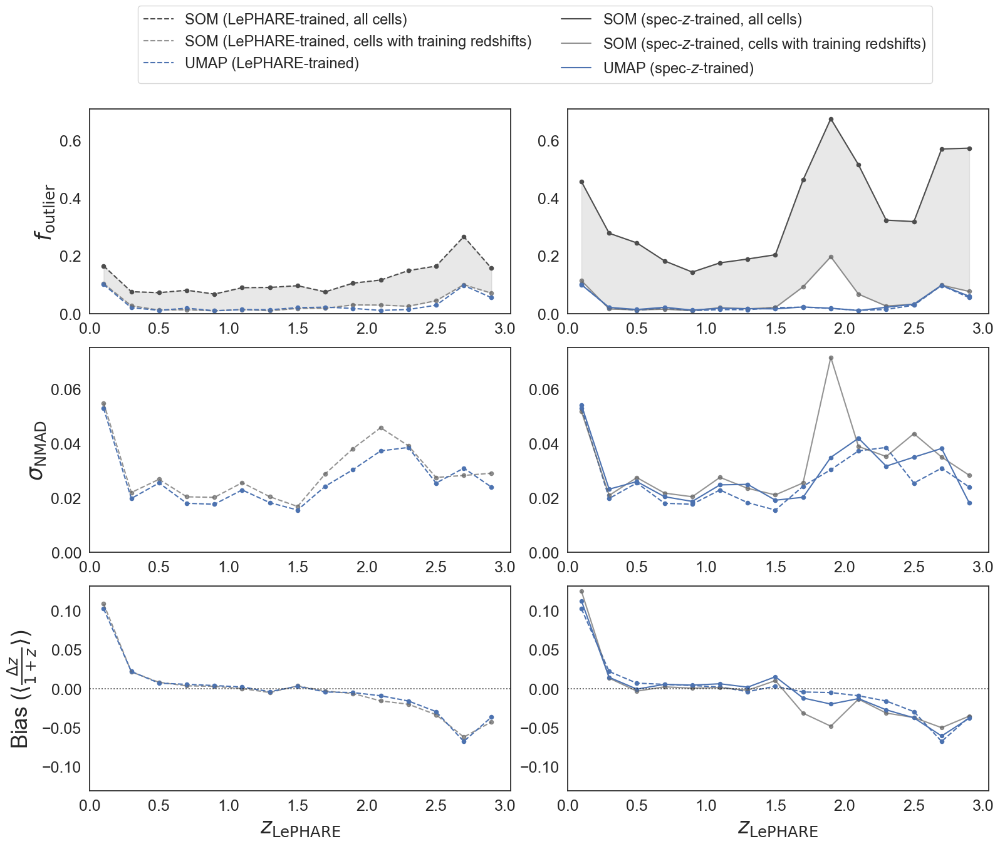

In [17]:
# plot the Figure!
umapz.z_binned_stats(fullcat_lp=df_test_lp, fullcat_spec=df_test_spec, umap_test_lp=umap_test_lp, umap_test_spec=umap_test_spec, som_test_lp=som_test_lp, som_test_spec=som_test_spec, i_vals='TEST_Z', t_vals='lp_photoz')


# SECTION: WORKING IN THE COLOR SPACE DIRECTLY

##### In order to illustrate the strengths and weaknesses of working in the compressed three-dimensional color space we created with UMAP, we can compare to working in the original seven-dimensional input color space. In this section, we illustrate this with the same tests we used to compare the UMAP to the SOM.

##### Using the interpolator_colors function of umapz, we can produce redshift estimates analogously to our UMAP-kNN-z estimates, by taking the median redshift of the k nearest neighbors in the seven-dimensional color space. For convenience, we'll refer to this as "colors-kNN-z" throughout this section.

In [22]:
## estimate the redshifts via interpolating in the seven-dimensional color space
# LePHARE-trained case:
c_test_lp = umapz.interpolator_colors(df1=df_train_lp, df2=df_test_lp, coords=['u-g', 'g-r', 'r-i', 'i-z', 'z-y',
                                                                'y-J', 'J-H'], nn=17, calc='median', z_true='lp_photoz', p=1)
# spec-z-trained case:
c_test_spec = umapz.interpolator_colors(df1=df_train_spec, df2=df_test_spec, coords=['u-g', 'g-r', 'r-i', 'i-z', 'z-y',
                                                                'y-J', 'J-H'], nn=17, calc='median', z_true='specz', p=1)

In [27]:
print('colors-kNN-z, LePHARE-trained case:')
print('NMAD:', np.round(umapz.calc_nmad(i_vals=c_test_lp['TEST_Z'], t_vals=c_test_lp['lp_photoz']),4))
print('f_outlier:', np.round(umapz.f_outlier(i_vals=c_test_lp['TEST_Z'], t_vals=c_test_lp['lp_photoz']),4))
print('bias:', np.round(umapz.calc_bias(i_vals=c_test_lp['TEST_Z'], t_vals=c_test_lp['lp_photoz']),4))

colors-kNN-z, LePHARE-trained case:
NMAD: 0.0182
f_outlier: 0.0205
bias: 0.004


In [28]:
print('colors-kNN-z, spec-z-trained case:')
print('NMAD:', np.round(umapz.calc_nmad(i_vals=c_test_spec['TEST_Z'], t_vals=c_test_spec['lp_photoz']),4))
print('f_outlier:', np.round(umapz.f_outlier(i_vals=c_test_spec['TEST_Z'], t_vals=c_test_spec['lp_photoz']),4))
print('bias:', np.round(umapz.calc_bias(i_vals=c_test_spec['TEST_Z'], t_vals=c_test_spec['lp_photoz']),4))

colors-kNN-z, spec-z-trained case:
NMAD: 0.0223
f_outlier: 0.0265
bias: 0.0016


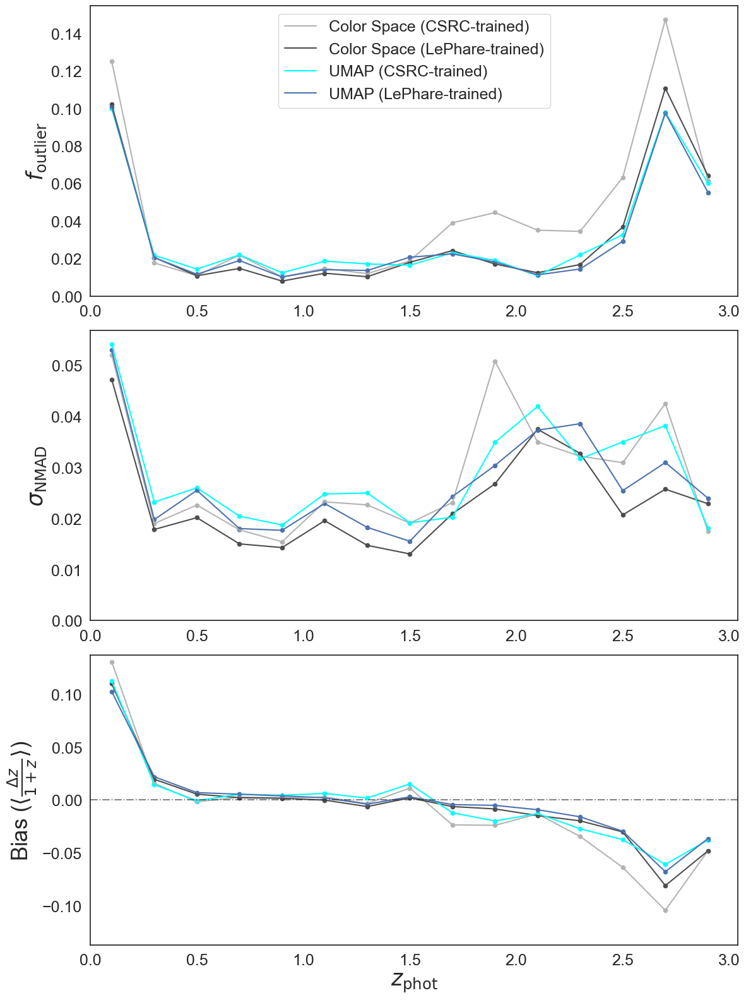

In [30]:
# plot the Figure!
umapz.z_binned_umap_vs_colors(fullcat_lp=df_test_lp, fullcat_spec=df_test_spec, umap_test_lp=umap_test_lp, umap_test_spec=umap_test_spec, c_test_lp=c_test_lp, c_test_spec=c_test_spec, i_vals='TEST_Z', t_vals='lp_photoz')

##### As described in Section 5 of our paper, we find that although some information has been inherently lost in reducing the dimensionality of the space from seven to three, the UMAP embedding works quite well. 

##### Similarly to Figure 5 in our paper (produced using the previous section of this notebook), the closeness of the two blue curves on this plot illustrates that neighbors-based redshift estimation in the UMAP space is very robust to the sparse and biased sampling of the color space offered by the spectroscopic data. 

##### Interestingly, both training cases of UMAP-kNN-z are quite close to colors-kNN-z in the LePHARE-trained case, while colors-kNN-z in the spec-z-trained case is generally the worst-performing of the four. This is particularly notable in the case of f_outlier and bias at redshifts z>1.5, where the sampling of the color space by spectroscopic data becomes very sparse, as well as in the spike in NMAD at z~1.9, which we also found in the performance of SOM-z in the spec-z-trained case. Altogether, these results seem to reinforce our finding that working in UMAP-compressed spaces is particularly advantageous in regimes sampled in a sparse and biased way, and that the well-organized and physically-meaningful nature of our UMAP embedding mitigates the impact of spectroscopic bias.

# Thank you for using our tutorial!

### If this was useful to you, we ask that you cite our work.

### All questions and concerns can be directed to the author by emailing finianashmead@pitt.edu